In [8]:
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

In [ ]:
M01_DC_train = pd.read_csv("../phm_etching_01M01-02/01_M01_DC_train.csv", encoding="utf8")

In [2140]:
# https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.subplot.html
# https://matplotlib.org/stable/gallery/subplots_axes_and_figures/subplots_demo.html
# https://stackoverflow.com/questions/14770735/how-do-i-change-the-figure-size-with-subplots

fig, axs = plt.subplots(17, 1, figsize=(150,50))

axs[0].plot(M01_DC_train.loc[:, 'IONGAUGEPRESSURE'])
axs[0].set_title("IONGAUGEPRESSURE")
axs[1].plot(M01_DC_train.loc[:, 'ETCHBEAMVOLTAGE'])
axs[1].set_title('ETCHBEAMVOLTAGE')
axs[2].plot(M01_DC_train.loc[:, 'ETCHBEAMCURRENT'])
axs[2].set_title('ETCHBEAMCURRENT')
axs[3].plot(M01_DC_train.loc[:, 'ETCHSUPPRESSORVOLTAGE'])
axs[3].set_title('ETCHSUPPRESSORVOLTAGE')
axs[4].plot(M01_DC_train.loc[:, 'ETCHSUPPRESSORCURRENT'])
axs[4].set_title('ETCHSUPPRESSORCURRENT')
axs[5].plot(M01_DC_train.loc[:, 'FLOWCOOLFLOWRATE'])
axs[5].set_title('FLOWCOOLFLOWRATE')
axs[6].plot(M01_DC_train.loc[:, 'FLOWCOOLPRESSURE'])
axs[6].set_title('FLOWCOOLPRESSURE')
axs[7].plot(M01_DC_train.loc[:, 'ETCHGASCHANNEL1READBACK'])
axs[7].set_title('ETCHGASCHANNEL1READBACK')
axs[8].plot(M01_DC_train.loc[:, 'ETCHPBNGASREADBACK'])
axs[8].set_title('ETCHPBNGASREADBACK')
axs[9].plot(M01_DC_train.loc[:, 'FIXTURETILTANGLE'])
axs[9].set_title('FIXTURETILTANGLE')
axs[10].plot(M01_DC_train.loc[:, 'ROTATIONSPEED'])
axs[10].set_title('ROTATIONSPEED')
axs[11].plot(M01_DC_train.loc[:, 'ACTUALROTATIONANGLE'])
axs[11].set_title('ACTUALROTATIONANGLE')
axs[12].plot(M01_DC_train.loc[:, 'FIXTURESHUTTERPOSITION'])
axs[12].set_title('FIXTURESHUTTERPOSITION')
axs[13].plot(M01_DC_train.loc[:, 'ETCHSOURCEUSAGE'])
axs[13].set_title('ETCHSOURCEUSAGE')
axs[14].plot(M01_DC_train.loc[:, 'ETCHAUXSOURCETIMER'])
axs[14].set_title('ETCHAUXSOURCETIMER')
axs[15].plot(M01_DC_train.loc[:, 'ETCHAUX2SOURCETIMER'])
axs[15].set_title('ETCHAUX2SOURCETIMER')
axs[16].plot(M01_DC_train.loc[:, 'ACTUALSTEPDURATION'])
axs[16].set_title('ACTUALSTEPDURATION')

plt.savefig('./Overview.svg', format='svg', bbox_inches="tight")

Index(['time', 'Tool', 'stage', 'Lot', 'runnum', 'recipe', 'recipe_step',
       'IONGAUGEPRESSURE', 'ETCHBEAMVOLTAGE', 'ETCHBEAMCURRENT',
       'ETCHSUPPRESSORVOLTAGE', 'ETCHSUPPRESSORCURRENT', 'FLOWCOOLFLOWRATE',
       'FLOWCOOLPRESSURE', 'ETCHGASCHANNEL1READBACK', 'ETCHPBNGASREADBACK',
       'FIXTURETILTANGLE', 'ROTATIONSPEED', 'ACTUALROTATIONANGLE',
       'FIXTURESHUTTERPOSITION', 'ETCHSOURCEUSAGE', 'ETCHAUXSOURCETIMER',
       'ETCHAUX2SOURCETIMER', 'ACTUALSTEPDURATION'],
      dtype='object')
Index(['time', 'TTF_FlowCool Pressure Dropped Below Limit',
       'TTF_Flowcool Pressure Too High Check Flowcool Pump',
       'TTF_Flowcool leak'],
      dtype='object')


c:\users\user\anaconda3\envs\monpa\lib\site-packages\matplotlib\textpath.py:65: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)


# Segmenting Sensor Data before Failure

In [1]:
from tqdm import tqdm
import numpy as np
import pandas as pd

In [2]:
M01_DC_train = pd.read_csv("../phm_etching_01M01-02/01_M01_DC_train.csv", encoding="utf8")

In [4]:
# parameters
SEGMENTATION_RANGE = 500000

faultTime_FlowcoolPressureTooHighCheckFlowcoolPump = [12633978, 
                                                      18541016, 26098946, 39525730, 40564654]
faultTime_FlowCoolPressureDroppedBelowLimit = [6533184, 8286500, 8627086, 8697338, 8971400, 12827950,
                   14026692, 15827488, 31185146, 40082846, 42056636]

faultTime_FlowcoolLeak = [20174938]


file_num = 0
for faultTimeIndex, faultTime in enumerate(tqdm(faultTime_FlowcoolPressureTooHighCheckFlowcoolPump + \
faultTime_FlowCoolPressureDroppedBelowLimit + faultTime_FlowcoolLeak)):
    
    # reset index when dealing with second list
    if faultTimeIndex == len(faultTime_FlowcoolPressureTooHighCheckFlowcoolPump) or\
     faultTimeIndex == len(faultTime_FlowcoolPressureTooHighCheckFlowcoolPump +\
                           faultTime_FlowCoolPressureDroppedBelowLimit):
        file_num = 0
        
    timeIndex = M01_DC_train.loc[:, "time"].tolist().index(faultTime)

    starting_point = (timeIndex - SEGMENTATION_RANGE) if (timeIndex - SEGMENTATION_RANGE) > 0 else 0
    data_temp = M01_DC_train.iloc[starting_point: timeIndex + 1, :]
#     print(faultTime, timeIndex, (timeIndex - SEGMENTATION_RANGE))
    print(len(data_temp))
    
    # export data
    if faultTime in faultTime_FlowcoolPressureTooHighCheckFlowcoolPump:
        data_temp.to_csv("../phm_etching_01M01-02/M01_DC_train_FlowcoolPressureTooHighCheckFlowcoolPump_" + \
                         str(file_num) + ".csv", index=None, encoding="utf8")
        file_num += 1
    elif faultTime in faultTime_FlowCoolPressureDroppedBelowLimit:
        data_temp.to_csv("../phm_etching_01M01-02/M01_DC_train_FlowCoolPressureDroppedBelowLimit_" + \
                         str(file_num) + ".csv", index=None, encoding="utf8")
        file_num += 1
    else:
        data_temp.to_csv("../phm_etching_01M01-02/M01_DC_train_FlowcoolLeak_" + \
                         str(file_num) + ".csv", index=None, encoding="utf8")
        file_num += 1
        
        

  0%|          | 0/17 [00:00<?, ?it/s]

500001


  6%|▌         | 1/17 [00:08<02:12,  8.28s/it]

500001


 12%|█▏        | 2/17 [00:16<02:05,  8.37s/it]

500001


 18%|█▊        | 3/17 [00:25<01:57,  8.39s/it]

500001


 24%|██▎       | 4/17 [00:33<01:49,  8.42s/it]

500001


 29%|██▉       | 5/17 [00:42<01:41,  8.43s/it]

173175


 35%|███▌      | 6/17 [00:45<01:12,  6.58s/it]

354985


 41%|████      | 7/17 [00:51<01:04,  6.40s/it]

377786


 47%|████▋     | 8/17 [00:57<00:57,  6.40s/it]

386393


 53%|█████▎    | 9/17 [01:03<00:51,  6.44s/it]

420492


 59%|█████▉    | 10/17 [01:11<00:46,  6.65s/it]

500001


 65%|██████▍   | 11/17 [01:19<00:43,  7.20s/it]

500001


 71%|███████   | 12/17 [01:28<00:37,  7.58s/it]

500001


 76%|███████▋  | 13/17 [01:36<00:31,  7.85s/it]

500001


 82%|████████▏ | 14/17 [01:44<00:24,  8.04s/it]

500001


 88%|████████▊ | 15/17 [01:53<00:16,  8.17s/it]

500001


 94%|█████████▍| 16/17 [02:01<00:08,  8.27s/it]

500001


100%|██████████| 17/17 [02:10<00:00,  7.67s/it]


# Graphing faultTime Flow Cool Pressure Dropped Below Limit

In [44]:
from tqdm import tqdm
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt

# check if there's duplicated rows amd null values
# print(M01_DC_train.isnull().any())
# duplicateDFRow = M01_DC_train[M01_DC_train.duplicated()]
# print(duplicateDFRow)

100%|██████████| 11/11 [00:45<00:00,  4.15s/it]


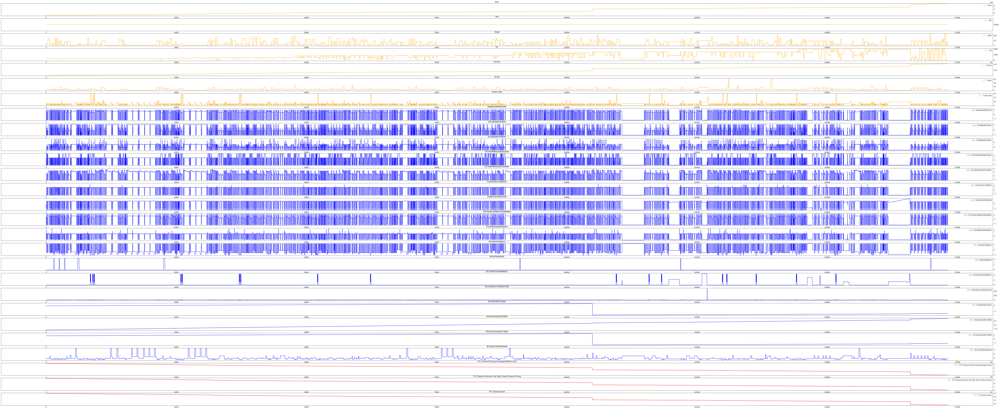

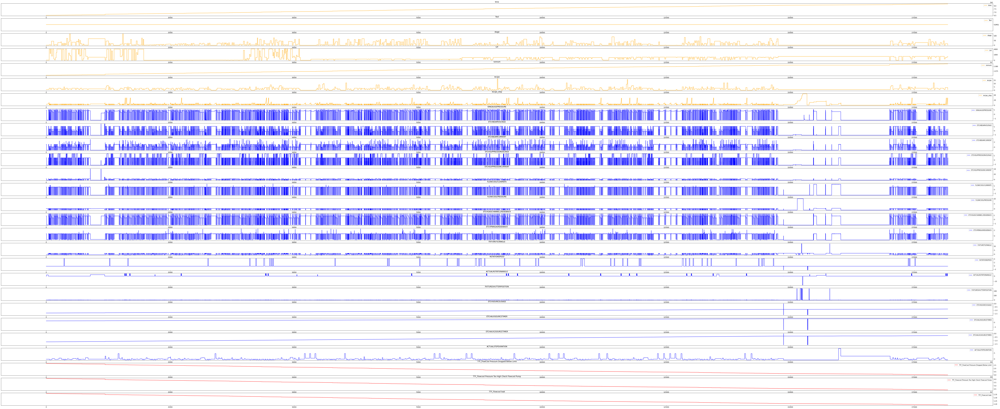

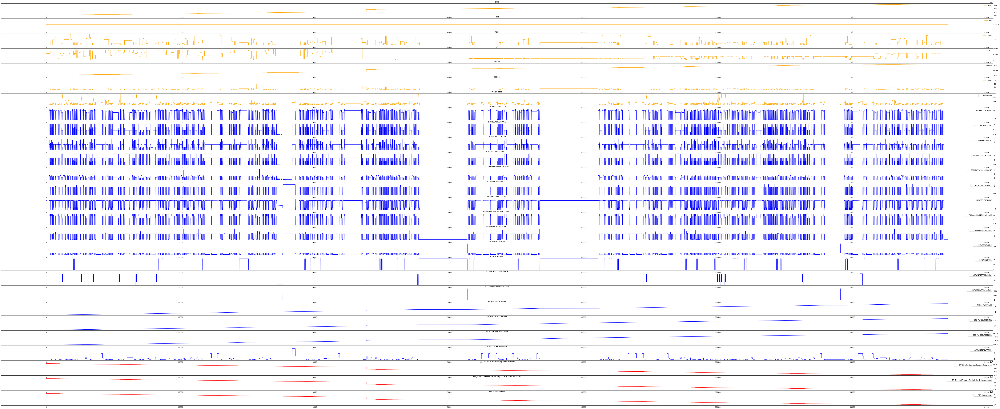

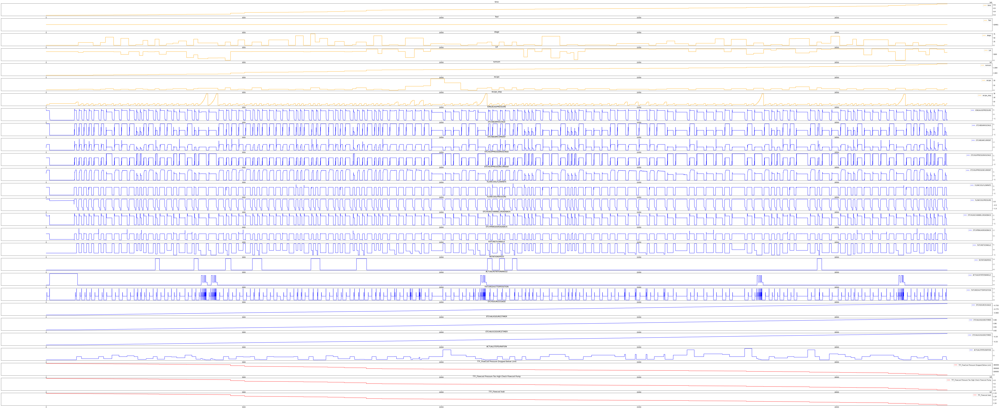

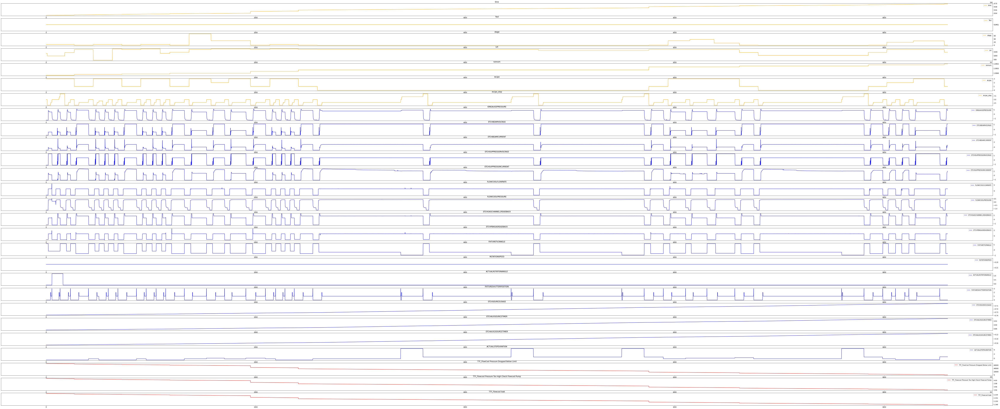

...

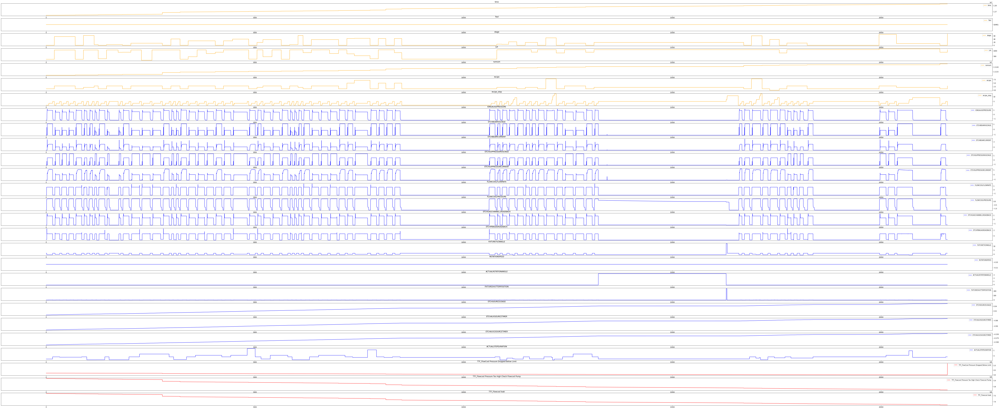

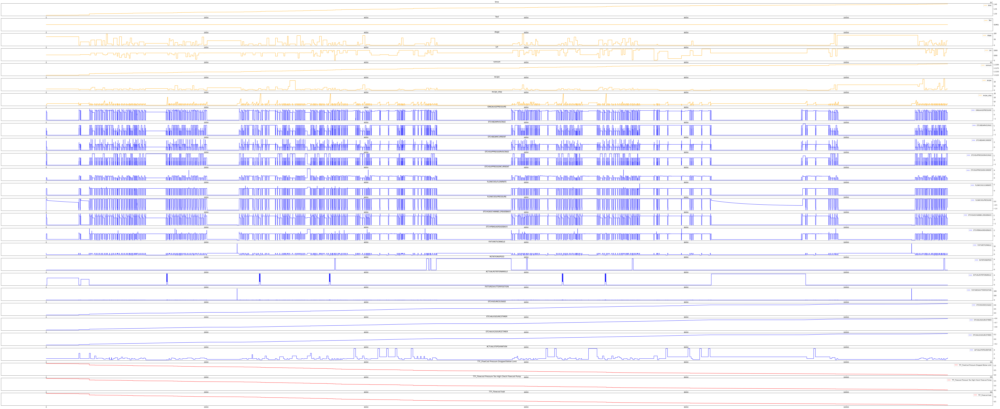

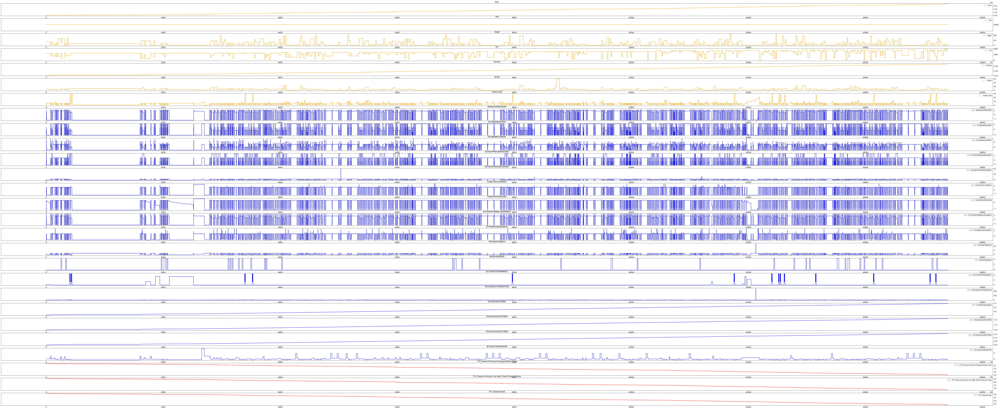

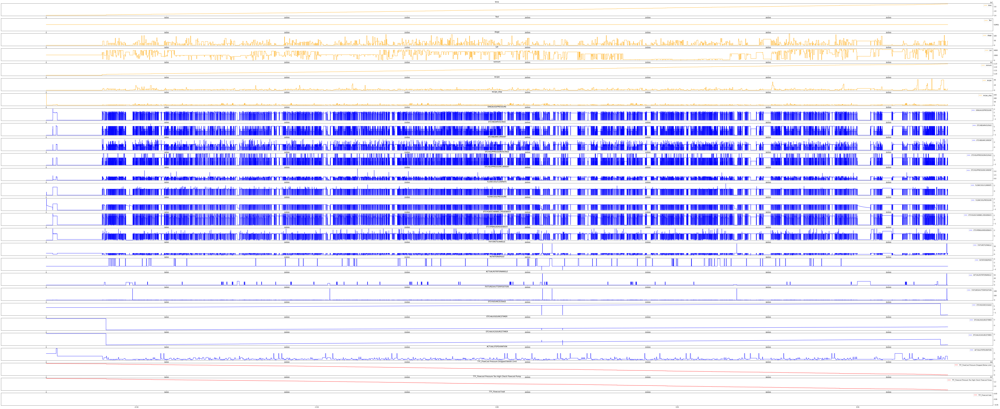

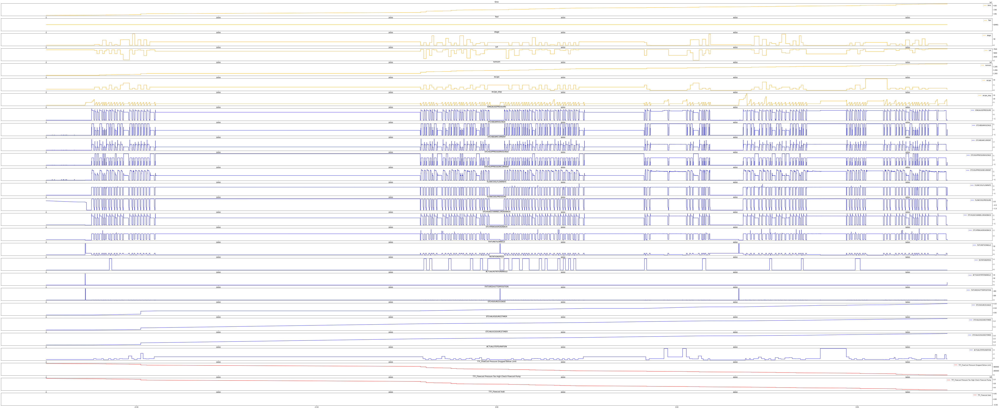

In [65]:
for fileIndex, file in enumerate(tqdm(os.listdir("../phm_etching_01M01-02/M01_DC_train_FlowCoolPressureDroppedBelowLimit/"))):
    M01_DC_train_original = pd.read_csv("../phm_etching_01M01-02/M01_DC_train_FlowCoolPressureDroppedBelowLimit/" + file,
                  encoding="utf8")
    M01_DC_train_ttf = pd.read_csv("../phm_etching_01M01-02/M01_DC_train_ttf_FlowCoolPressureDroppedBelowLimit/" +\
                                   file[:13] + "ttf" + file[12:],
                  encoding="utf8")
    
    M01_DC_train_original.drop_duplicates(inplace=True)
    M01_DC_train_ttf.drop_duplicates(inplace=True)
    M01_DC_train = M01_DC_train_original.merge(M01_DC_train_ttf, left_on="time", right_on="time",
                                           how="inner")
    
    fig, axs = plt.subplots(27, 1, figsize=(120,50))
    
    for columnIndex, column in enumerate(M01_DC_train.columns):
        color = "blue"        
        # select color
        if columnIndex < 7:
            color = "orange"
        elif columnIndex > 23:
            color = "red"
            
        axs[columnIndex].plot(M01_DC_train.iloc[:, columnIndex], label=column, color=color)
        axs[columnIndex].set_title(column)
        axs[columnIndex].legend(loc="upper right")
        axs[columnIndex].yaxis.tick_right()
    
    plt.savefig("./Graphs/" + file[:-4] +".svg", format='svg', bbox_inches="tight")

# Graphing Flowcool Pressure Too High Check Flowcool Pump

100%|██████████| 5/5 [00:26<00:00,  5.26s/it]


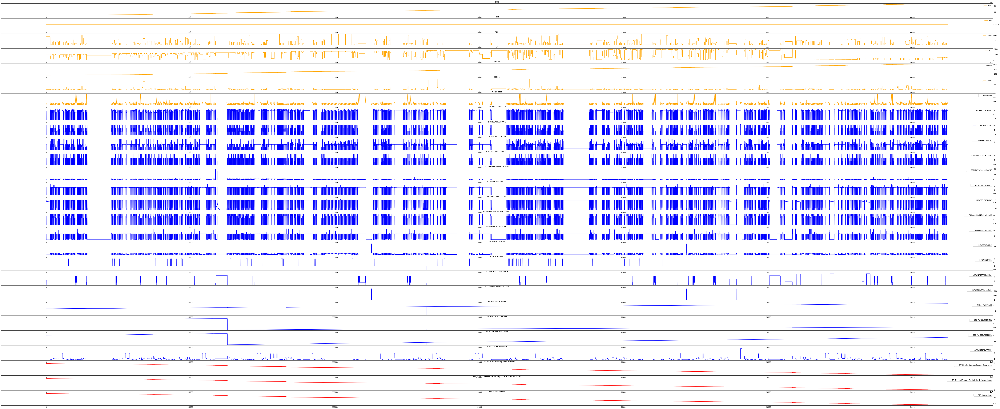

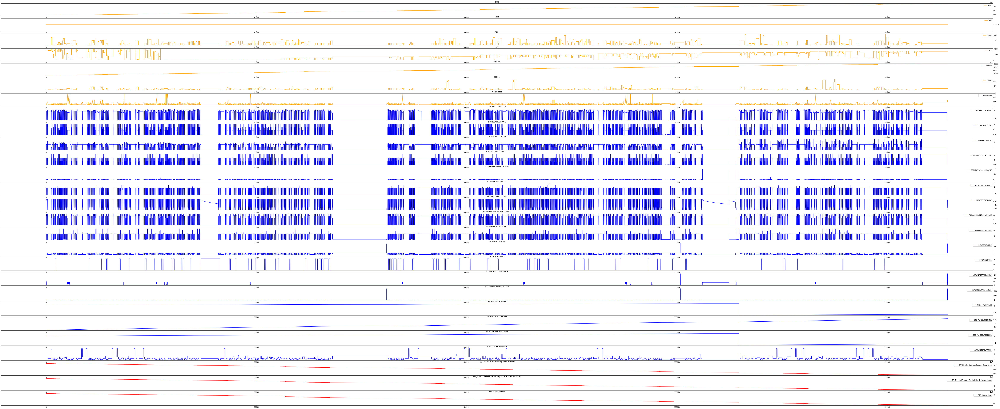

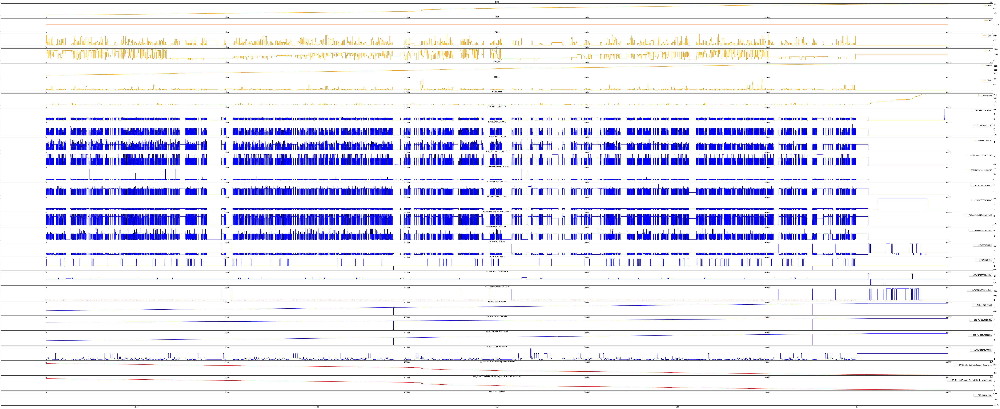

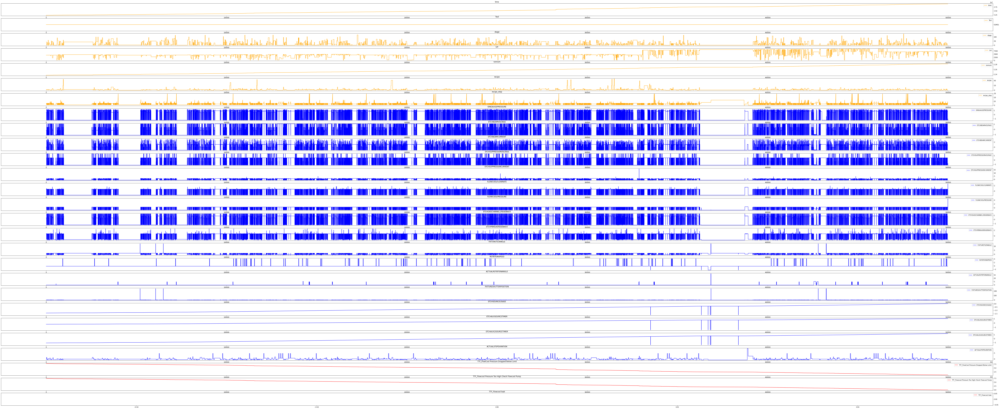

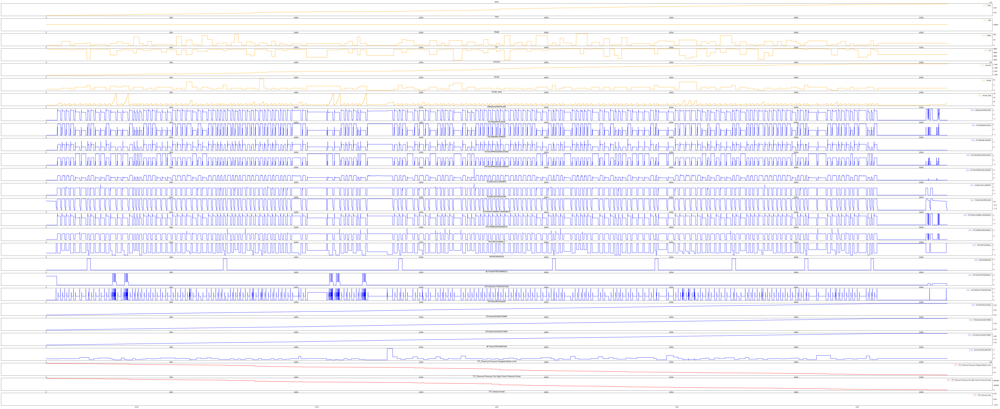

In [66]:
for fileIndex, file in enumerate(tqdm(os.listdir("../phm_etching_01M01-02/M01_DC_train_FlowcoolPressureTooHighCheckFlowcoolPump/"))):
    M01_DC_train_original = pd.read_csv("../phm_etching_01M01-02/M01_DC_train_FlowcoolPressureTooHighCheckFlowcoolPump/" + file,
                  encoding="utf8")
    M01_DC_train_ttf = pd.read_csv("../phm_etching_01M01-02/M01_DC_train_ttf_FlowcoolPressureTooHighCheckFlowcoolPump/" +\
                                   file[:13] + "ttf" + file[12:],
                  encoding="utf8")
    
    M01_DC_train_original.drop_duplicates(inplace=True)
    M01_DC_train_ttf.drop_duplicates(inplace=True)
    M01_DC_train = M01_DC_train_original.merge(M01_DC_train_ttf, left_on="time", right_on="time",
                                           how="inner")
    
    fig, axs = plt.subplots(27, 1, figsize=(120,50))
    
    for columnIndex, column in enumerate(M01_DC_train.columns):
        color = "blue"        
        # select color
        if columnIndex < 7:
            color = "orange"
        elif columnIndex > 23:
            color = "red"
            
        axs[columnIndex].plot(M01_DC_train.iloc[:, columnIndex], label=column, color=color)
        axs[columnIndex].set_title(column)
        axs[columnIndex].legend(loc="upper right")
        axs[columnIndex].yaxis.tick_right()
    
    plt.savefig("./Graphs/" + file[:-4] +".svg", format='svg', bbox_inches="tight")